In [8]:
from keras import Input, layers, backend, Model, losses, datasets, models, metrics, optimizers, initializers
from keras.regularizers import l2
from keras.utils import Sequence
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import os
import math

In [9]:
class FelixSequence(Sequence):
    def __init__(self, x_set, y_set, batch_size):
        """Here self.x is a list of paths to .npy input files. self.y is a
        corresponding list of paths to .npy output files."""
        self.x, self.y = x_set, y_set
        self.batch_size = batch_size

    def __len__(self):
        return int(np.ceil(len(self.x) / float(self.batch_size)))

    def __getitem__(self, idx):
        batch_x = self.x[idx * self.batch_size:(idx + 1) * self.batch_size]
        batch_y = self.y[idx * self.batch_size:(idx + 1) * self.batch_size]
        #print(np.array([np.load(file_name) for file_name in batch_x]).shape, np.array([np.load(file_name) for file_name in batch_y]).shape)
        return np.array([np.reshape(np.load(file_name), (128, 128, 1)) for file_name in batch_x]), np.array([np.reshape(np.load(file_name), (128, 128, 1)) for file_name in batch_y])
    

def gen_paths_labels(base_path = "D:\\Uni Work\\Masters Project\\electron_dists\\Data\\VAE_000_1\\Data"):
    """A generator to yield (data-paths, corresponding labels) tuples for each
    segment of data (typically training, validation, and testing)."""
    for segment in sorted(os.listdir(base_path)):
        segment_path = os.path.join(base_path, segment)
        input_paths = []
        output_paths = []
        for crystal in sorted(os.listdir(segment_path)):
            crystal_path = os.path.join(segment_path, crystal)
            files = sorted(os.listdir(crystal_path))
            input_paths.append(os.path.join(crystal_path, files[0]))
            output_paths.append(os.path.join(crystal_path, files[1]))
        yield [input_paths, output_paths]

def gen_paths_fromfile(Path):
    Paths = []
    with open(Path) as textFile:
        lines = [line.split() for line in textFile]
    for i in lines:
        Paths.append(i[0])
        
    Paths = np.array(Paths, dtype = "object")
    return(Paths)

In [10]:
latent_dim = 12
#lap = tf.compat.v1.distributions.Laplace(0.0,1.0)
"""
## Create a sampling layer
"""
class Sampling(layers.Layer):
    """Uses (z_mean, z_log_var) to sample z, the vector encoding a digit."""
    def __init__(self, gamma = 1, **kwargs):
        super(Sampling, self).__init__(**kwargs)
        self.gamma = gamma

    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        #epsilon = lap.sample(sample_shape=(batch, dim))
        #print(self.gamma)
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon * self.gamma


In [11]:
def ZMCC(Image1, Image2):
    sd1 = tf.math.reduce_std(Image1, axis = (1,2))
    mean1 = tf.math.reduce_mean(Image1, axis = (1,2), keepdims = True)
    
    sd2 = tf.math.reduce_std(Image2, axis = (1,2))
    mean2 = tf.math.reduce_mean(Image2, axis = (1,2), keepdims = True)

    img1 = (Image1 - mean1)
    img2 = (Image2 - mean2)
    img = img1*img2

    zmcc = 10000 * (1 - (1 / (128 * 128 * sd1 * sd2)) *  tf.reduce_sum(img, axis=(1,2)))
    return(zmcc)

In [12]:
"""
## Build the encoder
"""

Num_Kernals = 32
Size_Kernals = 8

class Encoder(Model):
    def __init__(self, gamma = 0, **kwargs):
        super(Encoder, self).__init__(**kwargs)

        self.Conv1 = layers.Conv2D(Num_Kernals, kernel_size = (Size_Kernals, Size_Kernals), activation="relu", strides=2, padding="same")
        self.Conv2 = layers.Conv2D(Num_Kernals, kernel_size = (Size_Kernals, Size_Kernals), activation="relu", strides=2, padding="same")
        #self.Conv3 = layers.Conv2D(Num_Kernals, kernel_size = (8, 8), activation="relu", strides=2, padding="same")
        #self.Conv4 = layers.Conv2D(Num_Kernals, kernel_size = (8, 8), activation="relu", strides=2, padding="same")

        self.flat = layers.Flatten()

        self.DenseParam_Encode = 1500000
        self.DenseNeurons_Encode = int(self.DenseParam_Encode / 16400)

        self.dense = layers.Dense(self.DenseNeurons_Encode, activation="relu")
        self.z_mean = layers.Dense(latent_dim, name="z_mean")
        self.z_log_var = layers.Dense(latent_dim, name="z_log_var", kernel_initializer='zeros', bias_initializer='zeros')
        self.sampling = Sampling(gamma=gamma)
    
    def call(self, inputs):

        x = self.Conv1(inputs)
        x = self.Conv2(x)
        #x = self.Conv3(x)
        #x = self.Conv4(x)
        x = self.flat(x)
        x = self.dense(x)
        z_mean = self.z_mean(x)
        z_log_var = self.z_log_var(x)
        z = self.sampling([z_mean, z_log_var])
        return z_mean, z_log_var, z
    
encoder = Encoder(gamma = 0, name="encoder")
encoder(Input(batch_shape=(None,128,128,1)))

encoder.summary()

Model: "encoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_2 (Conv2D)            (None, 64, 64, 32)        2080      
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 32, 32, 32)        65568     
_________________________________________________________________
flatten_1 (Flatten)          (None, 32768)             0         
_________________________________________________________________
dense_2 (Dense)              (None, 91)                2981979   
_________________________________________________________________
z_mean (Dense)               (None, 12)                1104      
_________________________________________________________________
z_log_var (Dense)            (None, 12)                1104      
_________________________________________________________________
sampling_1 (Sampling)        (None, 12)                0   

In [13]:
"""
## Build the decoder
"""


class Decoder(Model):
    def __init__(self, encoder_layer, **kwargs):
        super(Decoder, self).__init__(**kwargs)
        Dense_Size = encoder_layer[1]
        
        DenseParam_Decode = 1500000
        Dense_Depth = int(DenseParam_Decode / (latent_dim * Dense_Size * Dense_Size))
        
        self.dense1 = layers.Dense(Dense_Size * Dense_Size * Dense_Depth, activation="relu")
        self.dense2 = layers.Reshape((Dense_Size, Dense_Size, Dense_Depth))
                
        self.convT1 = layers.Conv2DTranspose(Num_Kernals, kernel_size = (Size_Kernals, Size_Kernals), activation="relu", strides=2, padding="same")
        self.convT2 = layers.Conv2DTranspose(Num_Kernals, kernel_size = (Size_Kernals, Size_Kernals), activation="relu", strides=2, padding="same")
        #self.convT3 = layers.Conv2DTranspose(Num_Kernals, kernel_size = (8, 8), activation="relu", strides=2, padding="same")
        #self.convT4 = layers.Conv2DTranspose(Num_Kernals, kernel_size = (8, 8), activation="relu", strides=2, padding="same")

        self.outputs = layers.Conv2DTranspose(1, kernel_size = (2, 2), activation="relu", padding= "same")
    
    def call(self, inputs):
        x = self.dense1(inputs)
        x = self.dense2(x)
                
        x = self.convT1(x)
        x = self.convT2(x)
        #x = self.convT3(x)
        #x = self.convT4(x)
        
        output = self.outputs(x)
        
        return output
    
decoder = Decoder(encoder.layers[1].output_shape, name="decoder")
decoder(Input(batch_shape=(None, latent_dim)))
decoder.summary()

Model: "decoder"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3 (Dense)              (None, 124928)            1624064   
_________________________________________________________________
reshape_1 (Reshape)          (None, 32, 32, 122)       0         
_________________________________________________________________
conv2d_transpose_3 (Conv2DTr (None, 64, 64, 32)        249888    
_________________________________________________________________
conv2d_transpose_4 (Conv2DTr (None, 128, 128, 32)      65568     
_________________________________________________________________
conv2d_transpose_5 (Conv2DTr (None, 128, 128, 1)       129       
Total params: 1,939,649
Trainable params: 1,939,649
Non-trainable params: 0
_________________________________________________________________


In [14]:
class VAE(Model):
    def __init__(self, encoder, decoder, **kwargs):
        super(VAE, self).__init__(**kwargs)
        self.encoder = encoder
        self.decoder = decoder
        self.total_loss_tracker = metrics.Mean(name="total_loss")
        self.reconstruction_loss_tracker = metrics.Mean(
            name="reconstruction_loss"
        )
        self.kl_loss_tracker = metrics.Mean(name="kl_loss")

    @property
    def metrics(self):
        return [
            self.total_loss_tracker,
            self.reconstruction_loss_tracker,
            self.kl_loss_tracker
        ]

    def train_step(self, data):
        x, y = data
        with tf.GradientTape() as tape:
            z_mean, z_log_var, z = self.encoder(x)
            reconstruction = self.decoder(z)
            reconstruction_loss= tf.reduce_mean(ZMCC(reconstruction, y))
            #reconstruction_loss = tf.reduce_mean(
            #    tf.reduce_sum(
            #    losses.mean_squared_logarithmic_error(y, reconstruction), axis=(1, 2)
            #    )
            #)
            #print(z_mean, z_log_var, z)
            beta = 1
            kl_loss = (-0.5 * (1 + z_log_var - tf.square(z_mean) - tf.exp(z_log_var))) * beta
            kl_loss = tf.reduce_mean(tf.reduce_sum(kl_loss, axis=1))
            total_loss = reconstruction_loss + kl_loss
        grads = tape.gradient(total_loss, self.trainable_weights)
        self.optimizer.apply_gradients(zip(grads, self.trainable_weights))
        self.total_loss_tracker.update_state(total_loss)
        self.reconstruction_loss_tracker.update_state(reconstruction_loss)
        self.kl_loss_tracker.update_state(kl_loss)

        return {
            "loss": self.total_loss_tracker.result(),
            "reconstruction_loss": self.reconstruction_loss_tracker.result(),
            "kl_loss": self.kl_loss_tracker.result()
        }

    def call(self, data):
        return self.decoder(self.encoder(data)[2])

#losses.MSE(y, reconstruction), axis=(1, 2)
#losses.mean_squared_logarithmic_error(y, reconstruction), axis=(1, 2)

In [14]:
#vae = models.load_model("/home/ug-ml/felix-ML/VAE_000/Data/Models/VAE_3")

vae = VAE(encoder, decoder)
#vae.add_metric(trainable_metric(vae), name="testMetric")
vae.compile(optimizer=optimizers.Adam())


batch_size=32
data_path = "/home/ug-ml/felix-ML/VAE_000/DataAllInOne_Normalised/VAE_000_2/FilePaths/"


TrainingPathsInput = gen_paths_fromfile(data_path + "TrainingInput_0point1.txt")
TrainingPathsOutput = gen_paths_fromfile(data_path + "TrainingOutput_0point1.txt")

ValidationPathsInput = gen_paths_fromfile(data_path + "ValidationInput_0point1.txt")
ValidationPathsOutput = gen_paths_fromfile(data_path + "ValidationOutput_0point1.txt")

TestPathsInput = gen_paths_fromfile(data_path + "TestInput_0point1.txt")
TestPathsOutput = gen_paths_fromfile(data_path + "TestOutput_0point1.txt")

train_seq = FelixSequence(TrainingPathsInput, TrainingPathsOutput, batch_size)
val_seq = FelixSequence(ValidationPathsInput, ValidationPathsOutput, batch_size)
test_seq = FelixSequence(TestPathsInput, TestPathsOutput, batch_size)

#vae.fit(train_seq, shuffle=True, workers=16, epochs=1500)

epochs = 1500
patience = 100
best_model_name = "VAE_000_Normalised_0point1_HPopt_2"


patience_i = 0
best_val_loss = np.inf

#training and validation histories, containing [0] the total loss, [1] the reconstruction loss, and [2] the kl loss.
#val_hist = np.zeros(shape=(1,epochs))
#train_hist = np.zeros(shape=(3,epochs))

for epoch in range(0, epochs):
    print("-------------------------------------------------------------------------")
    print("Epoch", epoch, "/", epochs, ": ")
    print("Training: ")
    vae.encoder.sampling.gamma=1
    #print(vae.encoder.sampling.gamma)
    hist = vae.fit(x = train_seq, shuffle=True, epochs = epoch+1, workers = 16, initial_epoch=epoch)
    #train_hist[0][epoch] = hist.history["loss"][0]
    #train_hist[1][epoch] = hist.history["reconstruction_loss"][0]
    #train_hist[2][epoch] = hist.history["kl_loss"][0]
    print("Validation: ")

    tot_batch_recon_loss = 0
    count = 0
    vae.encoder.sampling.gamma=0
    #print(vae.encoder.sampling.gamma)
    for x, y in val_seq:
        #rint(x.shape, y.shape)
        count += 1
        reconstruction = vae(x)
        reconstruction_loss= tf.reduce_mean(ZMCC(reconstruction, y))
        #print(reconstruction.shape, y.shape, test.shape)
        #reconstruction_loss = tf.reduce_mean(
        #        tf.reduce_sum(
        #        losses.mean_squared_logarithmic_error(y, reconstruction), axis=(1, 2)
        #        )
        #    )
        tot_batch_recon_loss += reconstruction_loss
        #print(batch_log_loss)
    
    
    avg_recon_loss = float(tot_batch_recon_loss/count)
    if(avg_recon_loss < best_val_loss):
        vae.save("/home/ug-ml/felix-ML/VAE_000/DataAllInOne_Normalised/VAE_000_2/Models/"+str(best_model_name))
        print("The model improved from: ",best_val_loss, "to: ", avg_recon_loss)
        best_val_loss = avg_recon_loss
        patience_i = 0
    else:
        patience_i+=1
        print("The model did not improve, patience_i = ", patience_i)
        
    print("Average reconstruction loss: ", avg_recon_loss)
    #val_hist[0][epoch] = avg_recon_loss
    if(patience_i > patience):
        print("Early Stopping, the model did not improve from: ", best_val_loss)
        break

print("-------------------------------------------------------------------------")




-------------------------------------------------------------------------
Epoch 0 / 1500 : 
Training: 


IndexError: list index out of range

In [13]:
data_path = "/home/ug-ml/felix-ML/VAE_000/DataAllInOne_Normalised/VAE_000_2/FilePaths/"

TrainingPathsInput = gen_paths_fromfile(data_path + "TrainingInput_0point1.txt")
TrainingPathsOutput = gen_paths_fromfile(data_path + "TrainingOutput_0point1.txt")

ValidationPathsInput = gen_paths_fromfile(data_path + "ValidationInput_0point1.txt")
ValidationPathsOutput = gen_paths_fromfile(data_path + "ValidationOutput_0point1.txt")

TestPathsInput = gen_paths_fromfile(data_path + "TestInput_0point1.txt")
TestPathsOutput = gen_paths_fromfile(data_path + "TestOutput_0point1.txt")

vae = models.load_model("/home/ug-ml/felix-ML/VAE_000/DataAllInOne_Normalised/VAE_000_2/Models/VAE_000_Normalised_0point1_zmcc10000_1")

In [10]:
def ZMCC_loss(Image1, Image2):
    sd1 = np.std(Image1)
    mean1 = np.mean(Image1)
    
    sd2 = np.std(Image2)
    mean2 = np.mean(Image2)
    
    zmcc = 1 - (1 / (128 * 128 * sd1 * sd2)) * np.sum((Image1 - mean1) * (Image2 - mean2))
    return(zmcc)

def SaveLoss(PathsInput, PathsOutput, vae):
    Loss_List = np.zeros(len(PathsInput), dtype = np.float32)
    
    for i in range(0, len(PathsInput)):
        x = np.load(PathsInput[i])
        y = np.load(PathsOutput[i])
        a = np.reshape(vae(np.reshape(x, (1, 128, 128, 1))), (128, 128))
        loss =ZMCC_loss(y,a)
        Loss_List[i]=loss
    return(Loss_List)





In [ ]:
SaveLossDataPath = "/home/ug-ml/felix-ML/VAE_000/DataAllInOne_Normalised/VAE_000_2/DataAnalysis/0point1_data"
ValName = "/Validation_VAE_0point1_zmcc.npy"
TestName = "/Test_VAE_0point1_zmcc.npy"

Val_Loss_List = SaveLoss(ValidationPathsInput, ValidationPathsOutput, vae)
Test_Loss_List = SaveLoss(TestPathsInput, TestPathsOutput, vae)

np.save(SaveLossDataPath + ValName, Val_Loss_List)
np.save(SaveLossDataPath + TestName, Test_Loss_List)

In [ ]:
print(np.mean(Val_Loss_List), np.mean(Test_Loss_List))

0
ZMCC loss is:  0.026506719701406167


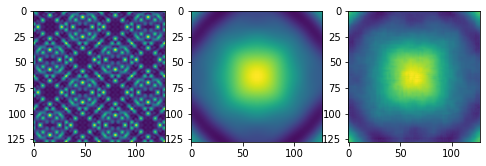

1
ZMCC loss is:  0.37517327784068677


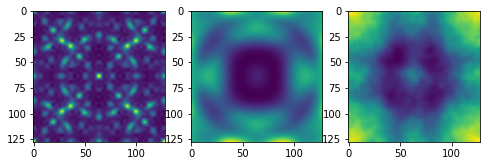

2
ZMCC loss is:  0.019230295940847464


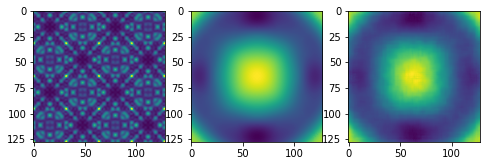

3
ZMCC loss is:  0.037155832877273975


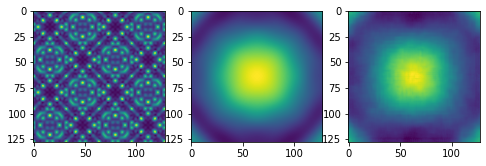

4
ZMCC loss is:  0.04349337190097413


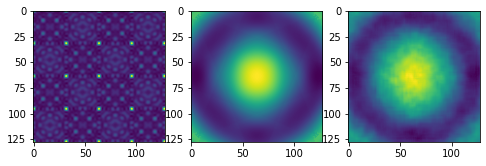

5
ZMCC loss is:  0.4524384249433282


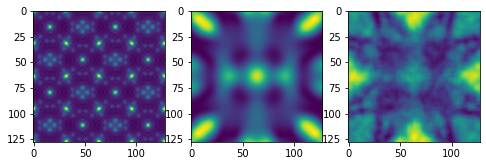

6
ZMCC loss is:  0.02112308705857624


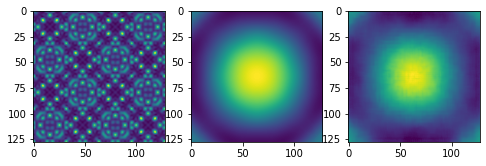

7
ZMCC loss is:  0.5121384049236617


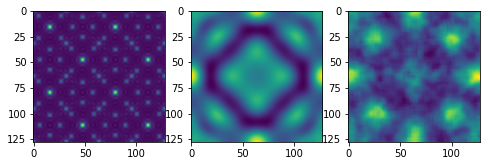

8
ZMCC loss is:  0.04850102008727364


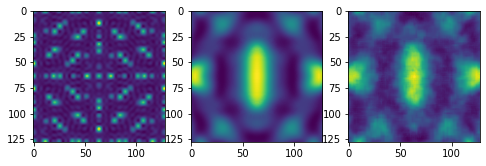

9
ZMCC loss is:  0.011707730953638085


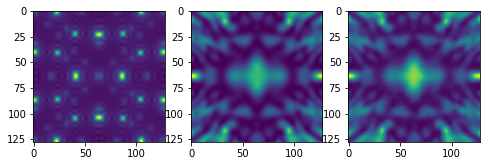

10
ZMCC loss is:  0.03973489606779279


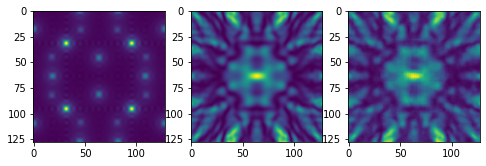

11
ZMCC loss is:  0.01831004274811887


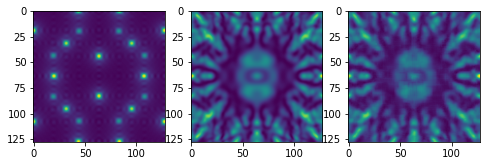

12
ZMCC loss is:  0.11209609797691744


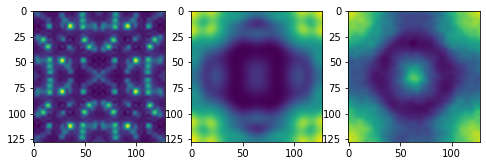

13
ZMCC loss is:  0.007080312307977454


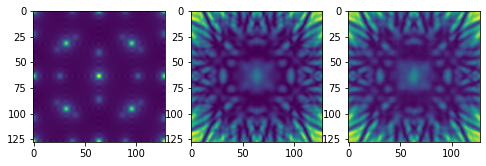

14
ZMCC loss is:  0.0965556081841209


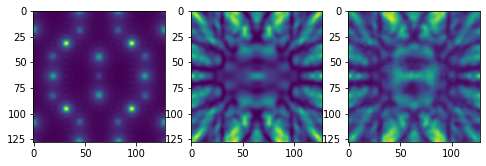

15
ZMCC loss is:  0.10187124917247226


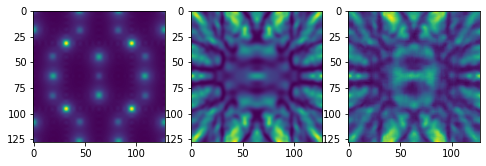

16
ZMCC loss is:  0.010472049389440907


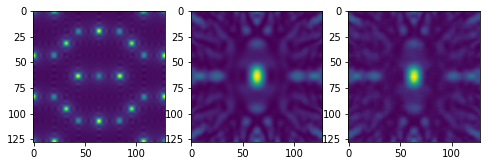

17
ZMCC loss is:  0.054361175694498165


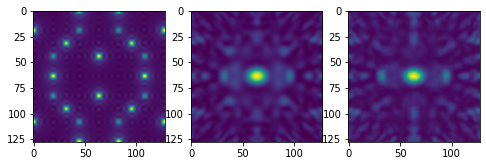

18
ZMCC loss is:  0.0031408314157025385


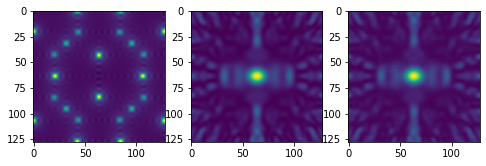

19
ZMCC loss is:  0.2750552628114121


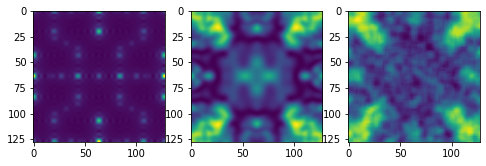

20
ZMCC loss is:  0.030767230189669315


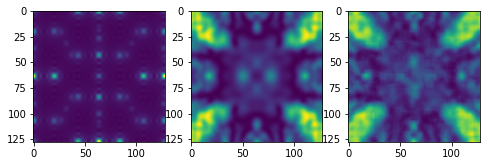

21
ZMCC loss is:  0.011069646117653598


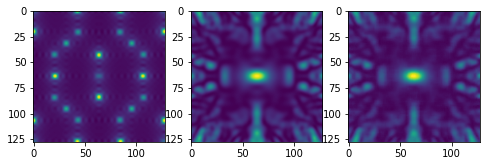

22
ZMCC loss is:  0.105135461998481


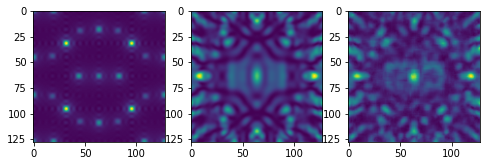

23
ZMCC loss is:  0.12521080701635223


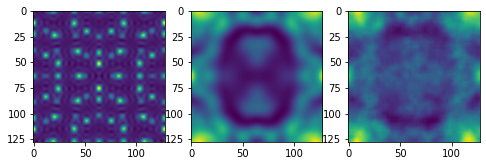

24
ZMCC loss is:  0.02308174640790417


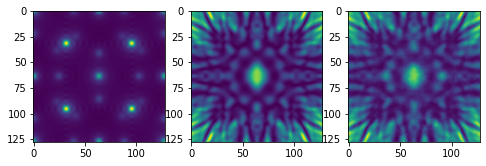

25
ZMCC loss is:  0.1128631783835321


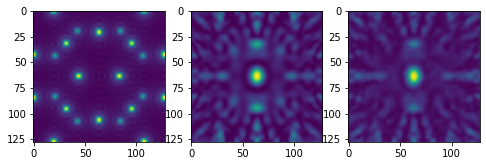

26
ZMCC loss is:  0.0715905141962544


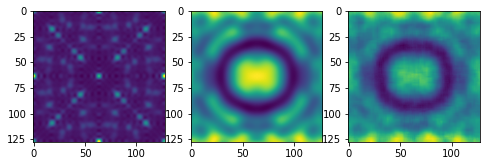

27
ZMCC loss is:  0.2003690745336908


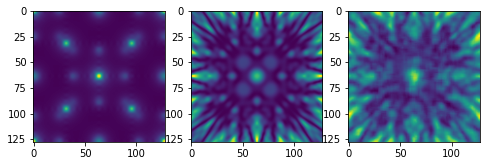

28
ZMCC loss is:  0.006345976967152334


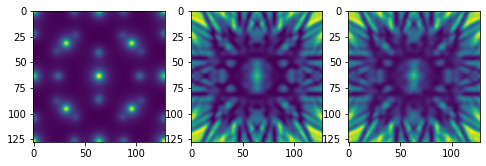

29
ZMCC loss is:  0.03058423249033848


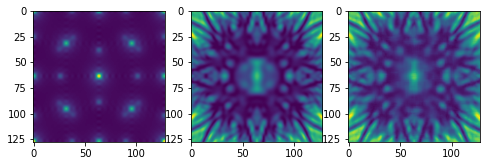

30
ZMCC loss is:  0.006674357785762086


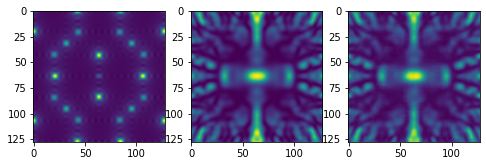

31
ZMCC loss is:  0.13570159122143832


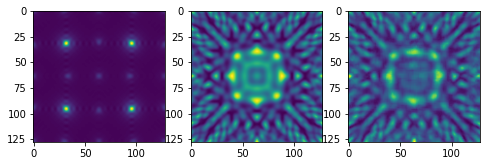

32
ZMCC loss is:  0.43895916042251304


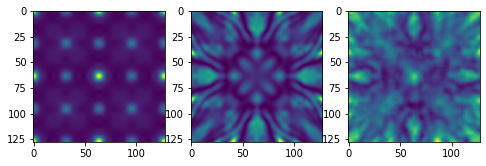

33
ZMCC loss is:  0.03205443784119899


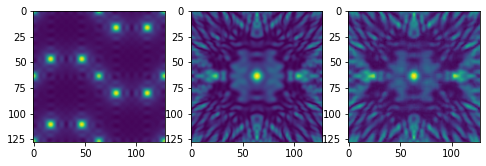

34
ZMCC loss is:  0.009548304015717601


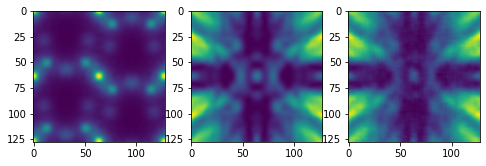

35
ZMCC loss is:  0.10157109304004575


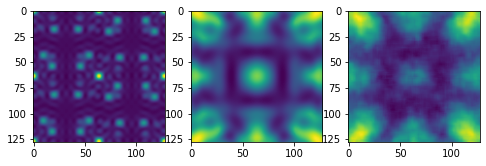

36
ZMCC loss is:  0.01831367205318024


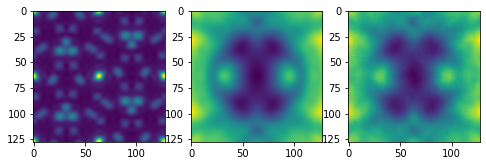

37
ZMCC loss is:  0.18776316197639908


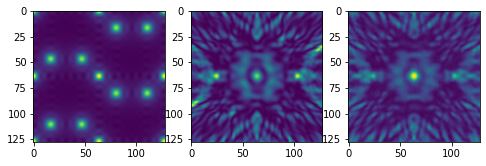

38
ZMCC loss is:  0.016486234264613264


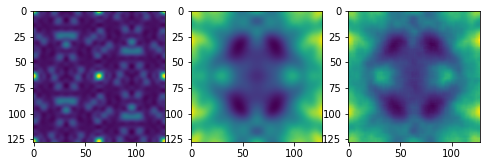

39
ZMCC loss is:  0.006369156362206918


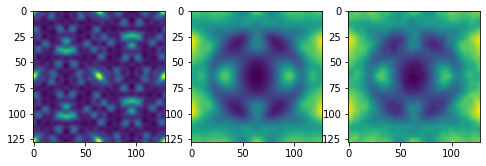

40
ZMCC loss is:  0.10427230260994513


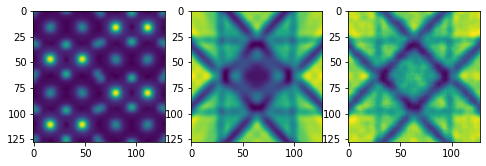

41
ZMCC loss is:  0.1428011096237538


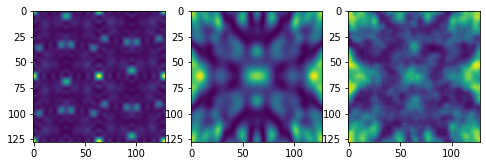

42
ZMCC loss is:  0.020093186629303594


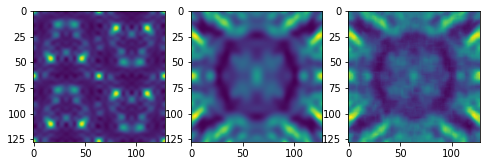

43
ZMCC loss is:  0.09381007149379228


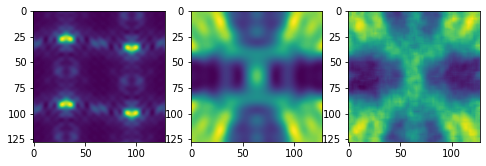

44
ZMCC loss is:  0.008042129016378574


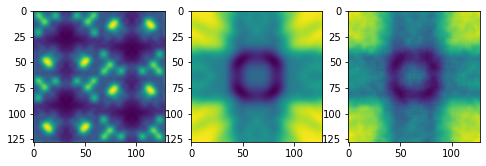

45
ZMCC loss is:  0.14733850312721763


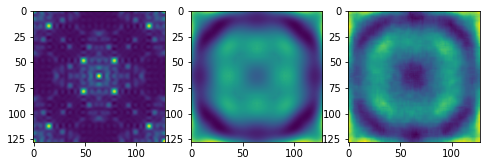

46
ZMCC loss is:  0.039221923952048265


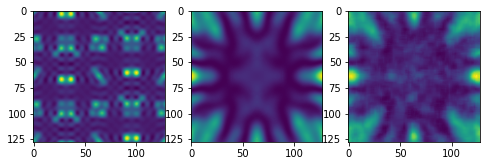

47
ZMCC loss is:  0.5622917157438266


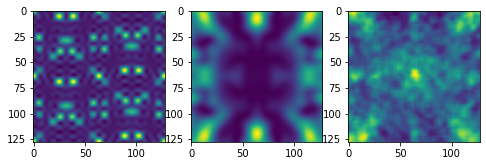

48
ZMCC loss is:  0.21709124839087213


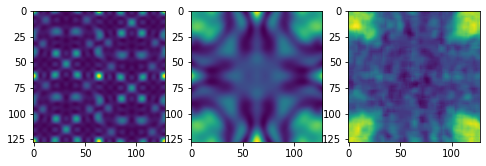

49
ZMCC loss is:  0.17636383009125378


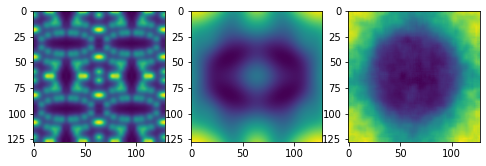

50
ZMCC loss is:  0.045269137143914784


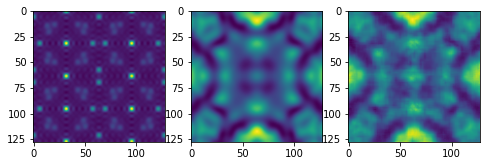

51
ZMCC loss is:  0.003381309384467901


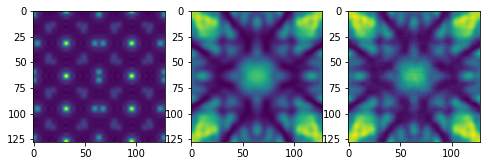

52
ZMCC loss is:  0.014571664007750229


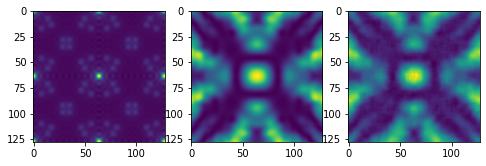

53
ZMCC loss is:  0.064035355190032


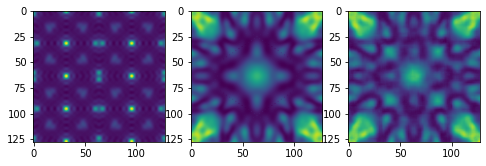

54
ZMCC loss is:  0.014471479234818618


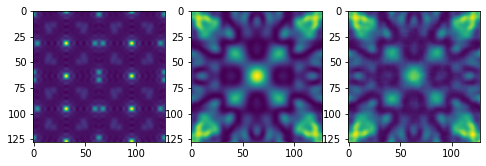

55
ZMCC loss is:  0.0029548617240543473


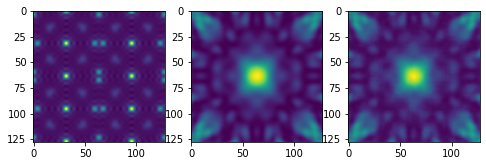

56
ZMCC loss is:  0.008355517670613377


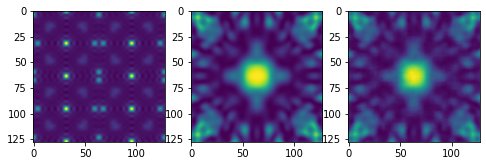

57
ZMCC loss is:  0.006757384396170352


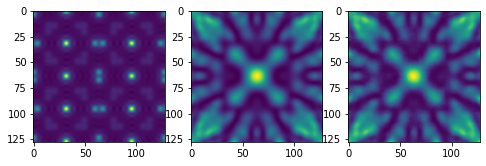

58
ZMCC loss is:  0.006295787434866695


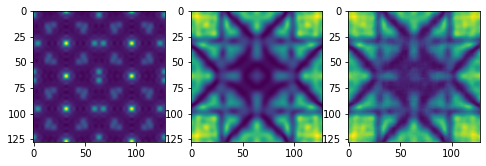

59
ZMCC loss is:  0.003395239476165046


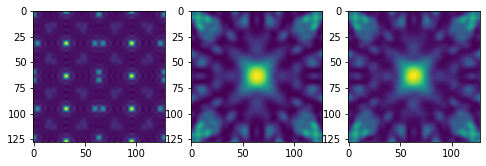

60
ZMCC loss is:  0.33244545275264514


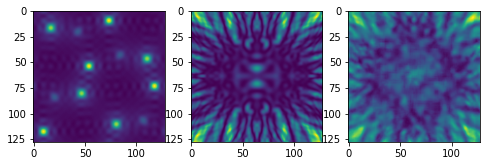

61
ZMCC loss is:  0.0504333538499151


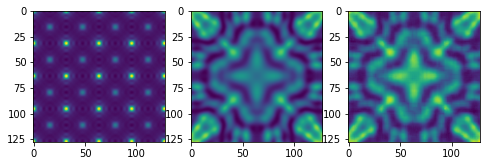

62
ZMCC loss is:  0.012845732139813215


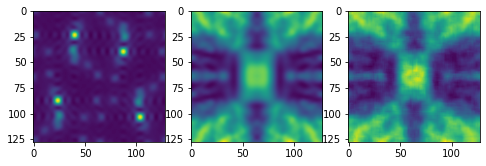

63
ZMCC loss is:  0.01958529193237879


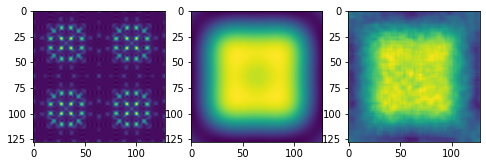

64
ZMCC loss is:  0.02024786804583789


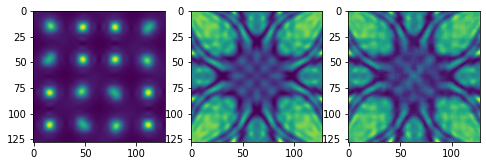

65
ZMCC loss is:  0.08074017459571159


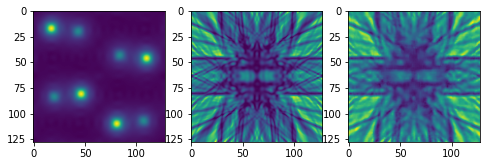

66
ZMCC loss is:  0.07203403296439836


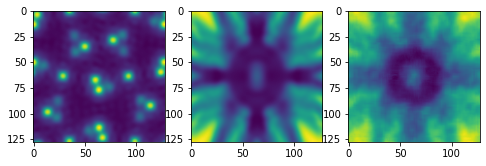

67
ZMCC loss is:  0.695676390883282


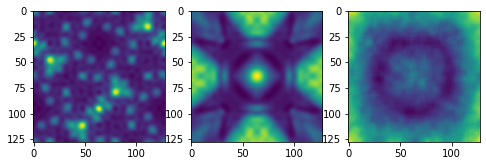

68
ZMCC loss is:  0.24863252497489663


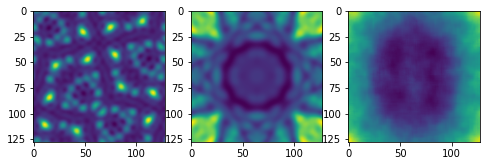

69
ZMCC loss is:  0.30570714174529934


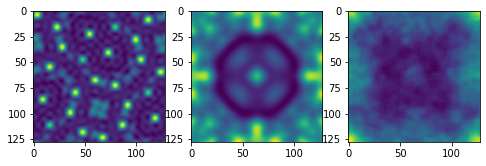

70
ZMCC loss is:  0.033127038610361925


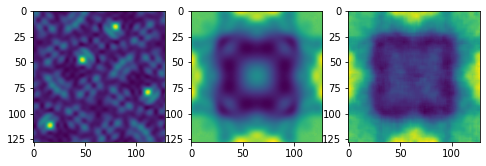

71
ZMCC loss is:  0.20122548752513314


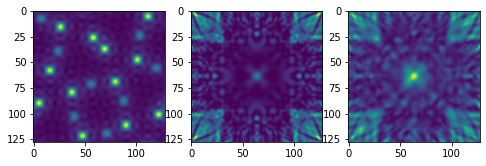

72
ZMCC loss is:  0.08519712033247995


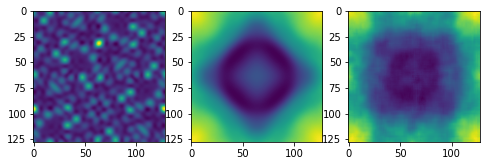

73
ZMCC loss is:  0.023717092754006908


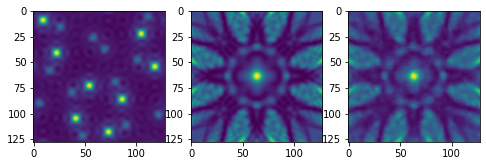

74
ZMCC loss is:  0.0882500829569296


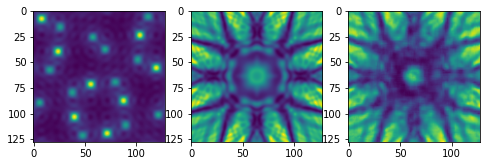

75
ZMCC loss is:  0.09554298191714039


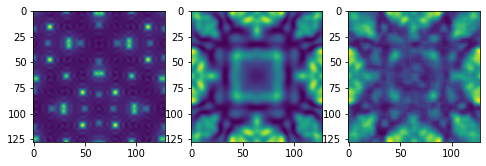

76
ZMCC loss is:  0.04111683690599088


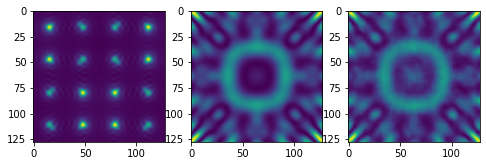

77
ZMCC loss is:  0.46839236928032735


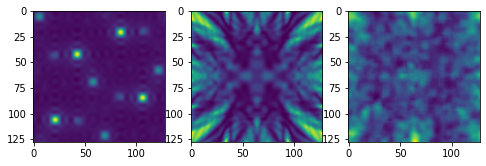

78
ZMCC loss is:  0.01430466828021315


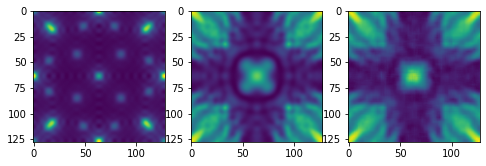

79
ZMCC loss is:  0.0148791583543042


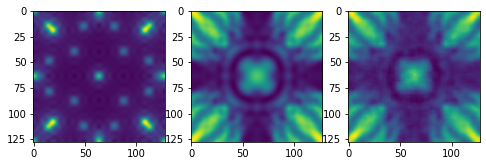

80
ZMCC loss is:  0.009915742030979113


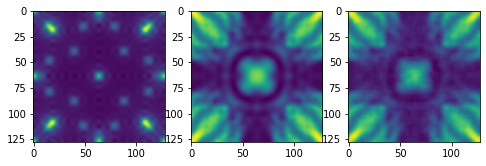

81
ZMCC loss is:  0.010683279285206404


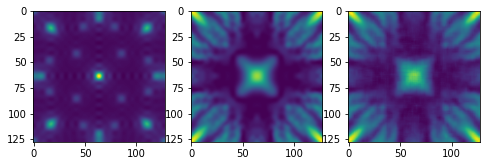

82
ZMCC loss is:  0.05200735963990122


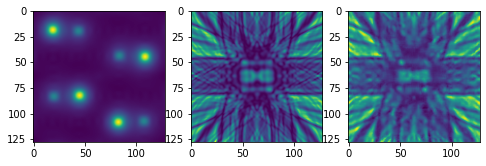

83
ZMCC loss is:  0.023919210089068166


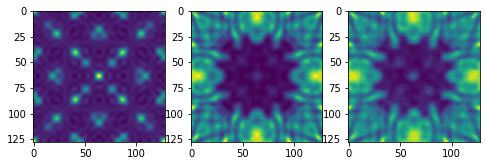

84
ZMCC loss is:  0.04663484843255583


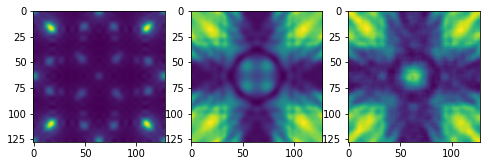

85
ZMCC loss is:  0.006472166457359596


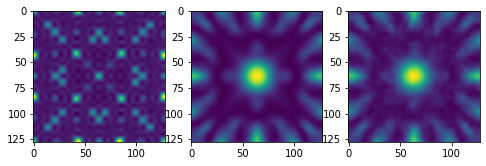

86
ZMCC loss is:  0.05696691173317914


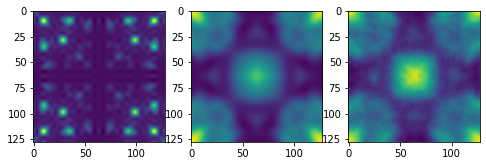

87
ZMCC loss is:  0.010919429826489413


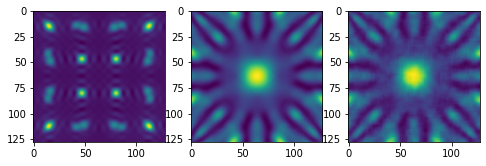

88
ZMCC loss is:  0.027731473876609125


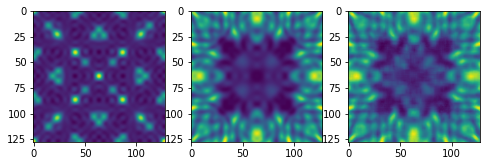

89
ZMCC loss is:  0.038325888794156326


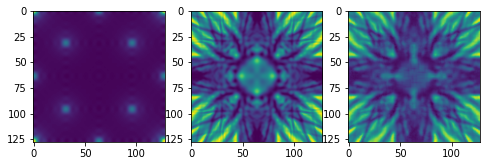

90
ZMCC loss is:  0.03558980756190078


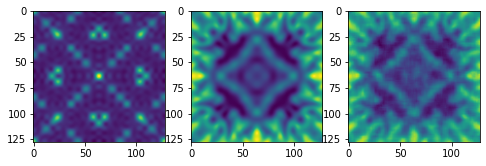

91
ZMCC loss is:  0.59036419888906


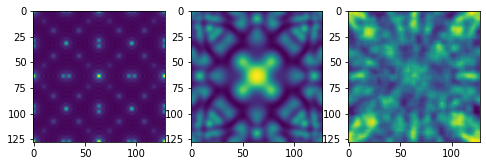

92
ZMCC loss is:  0.01311127736586104


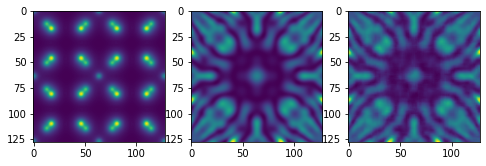

93
ZMCC loss is:  0.5298737702623085


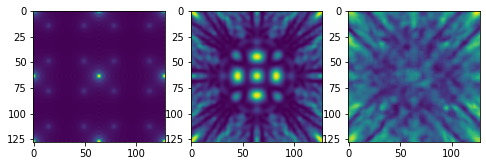

94
ZMCC loss is:  0.046920842445765


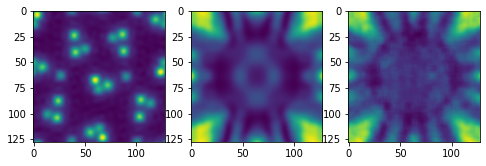

95
ZMCC loss is:  0.1195420267331303


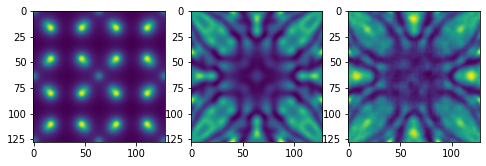

96
ZMCC loss is:  0.021360049304496198


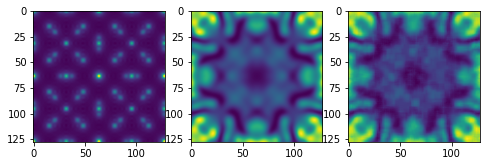

97
ZMCC loss is:  0.1978187822751838


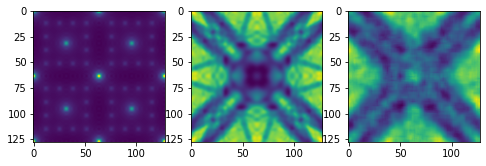

98
ZMCC loss is:  0.07211556074234626


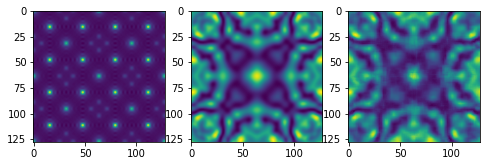

99
ZMCC loss is:  0.006764232711296558


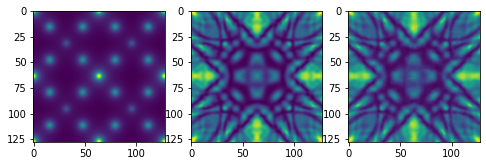

100
ZMCC loss is:  0.03821807653628195


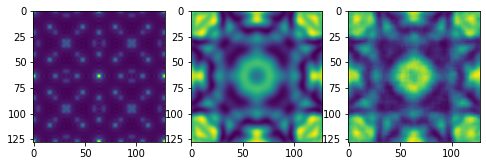

101
ZMCC loss is:  0.016758250905568706


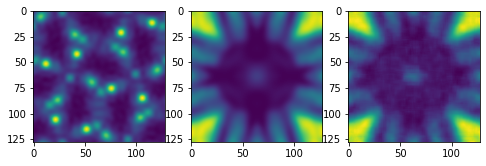

102
ZMCC loss is:  0.03913121394513175


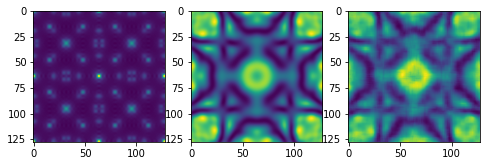

103
ZMCC loss is:  0.9031784866021136


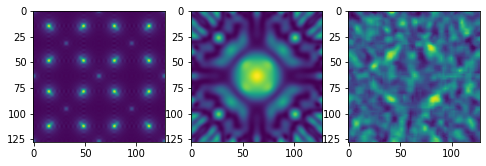

104
ZMCC loss is:  0.06072989078673907


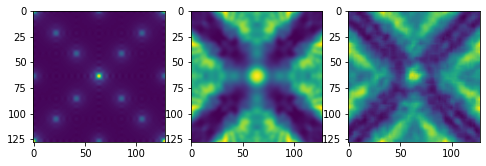

105
ZMCC loss is:  0.014476614766459783


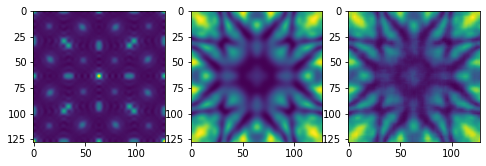

106
ZMCC loss is:  0.2006300284948489


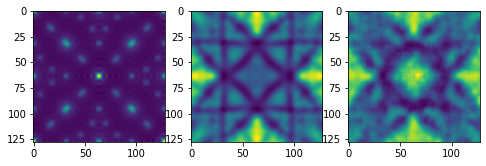

107
ZMCC loss is:  0.2085117573625508


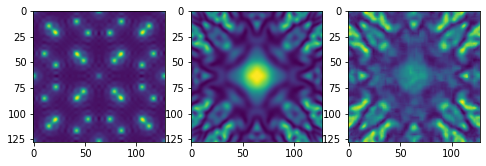

108
ZMCC loss is:  0.017386029565139904


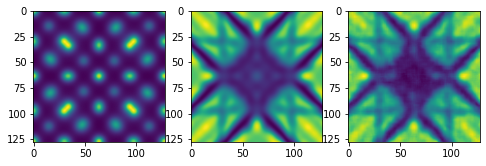

109
ZMCC loss is:  0.009880735407614805


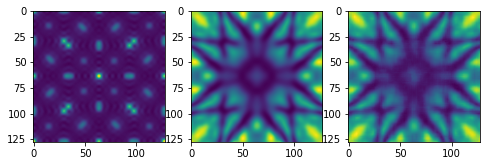

110
ZMCC loss is:  0.0047060236573730485


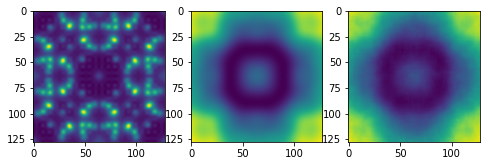

111
ZMCC loss is:  0.006619389319982849


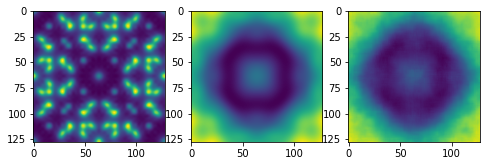

112
ZMCC loss is:  0.029961104688823736


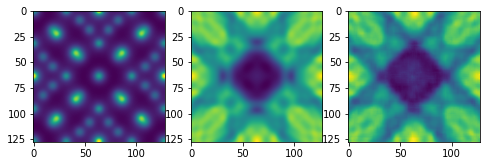

113
ZMCC loss is:  0.009853727535679146


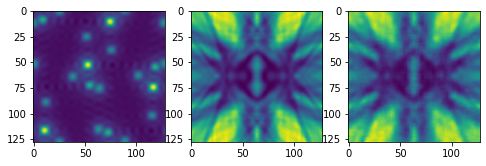

114
ZMCC loss is:  0.09593327828601084


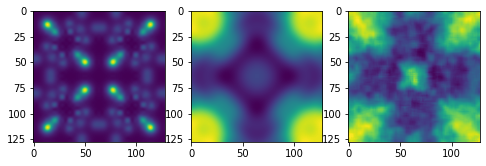

115
ZMCC loss is:  0.019352663688212757


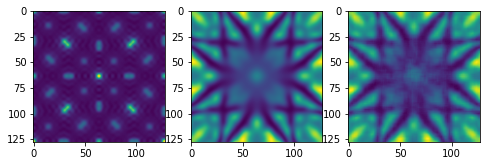

116
ZMCC loss is:  0.0022032437842866015


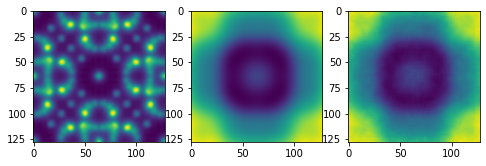

117
ZMCC loss is:  0.09786515771264281


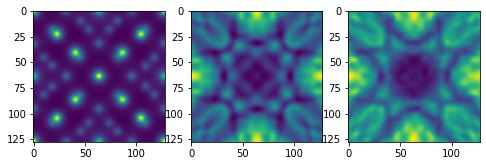

118
ZMCC loss is:  0.013155061555619185


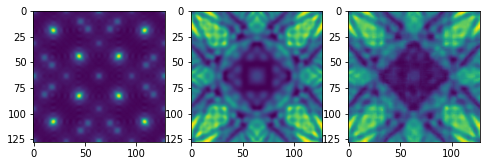

119
ZMCC loss is:  0.09896351265290815


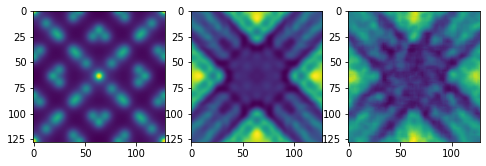

120
ZMCC loss is:  0.06944288050844638


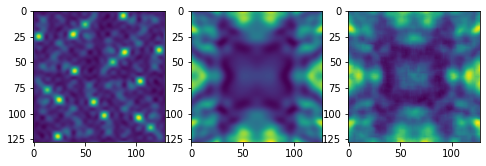

121
ZMCC loss is:  0.5418326687236578


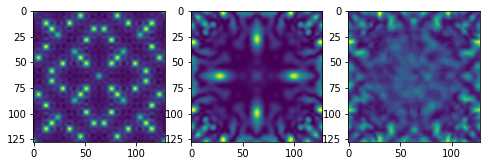

122
ZMCC loss is:  0.014330028426835617


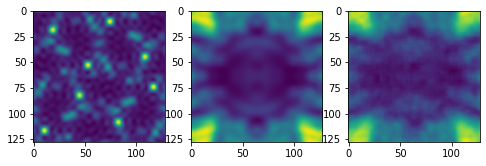

123
ZMCC loss is:  0.003558513273599795


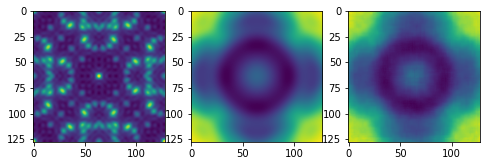

124
ZMCC loss is:  0.04067127764082401


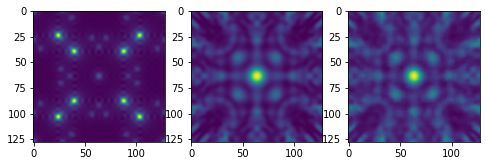

125
ZMCC loss is:  0.020065318163359436


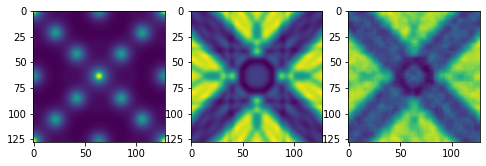

126
ZMCC loss is:  0.010780241211509667


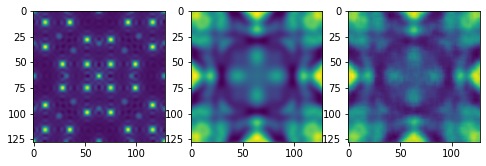

127
ZMCC loss is:  0.10717257247472689


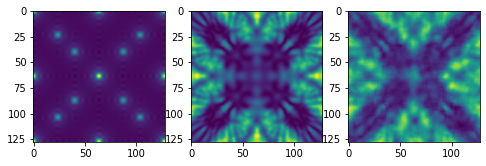

128
ZMCC loss is:  0.1345937833558285


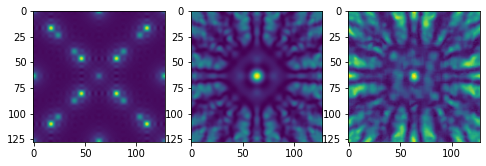

129
ZMCC loss is:  0.006629742253541848


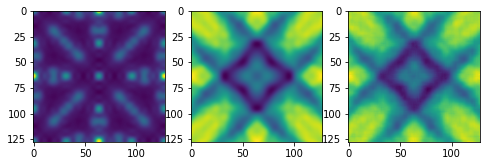

130
ZMCC loss is:  0.14210595948627847


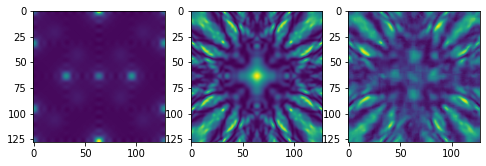

131
ZMCC loss is:  0.3289860251243768


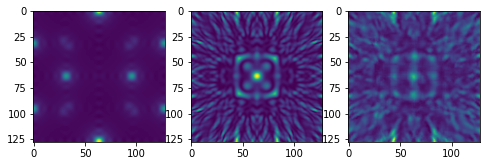

132
ZMCC loss is:  0.30166662743815886


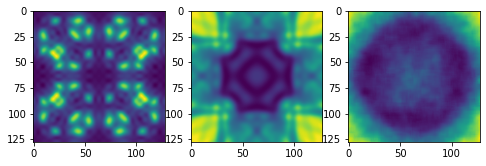

133
ZMCC loss is:  0.008502546541679146


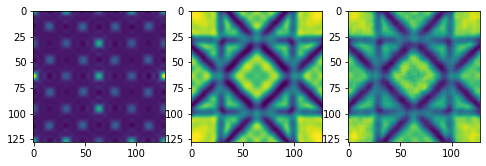

134
ZMCC loss is:  0.008685078460141882


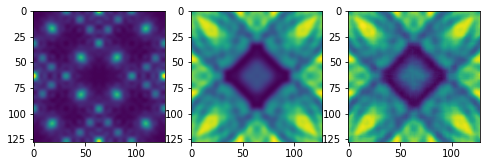

135
ZMCC loss is:  0.014050330672709221


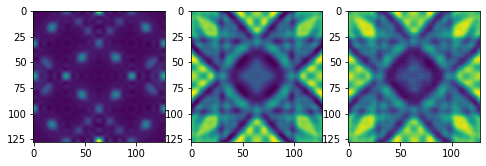

136
ZMCC loss is:  0.02101962465554219


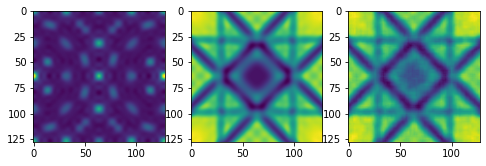

137
ZMCC loss is:  0.06769460518784742


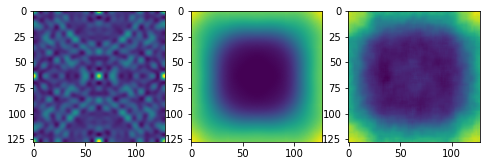

138
ZMCC loss is:  0.06984403200083966


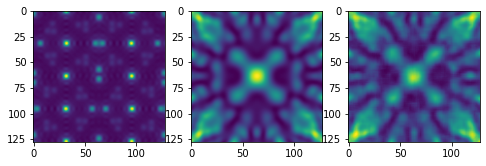

139
ZMCC loss is:  0.022327044872517132


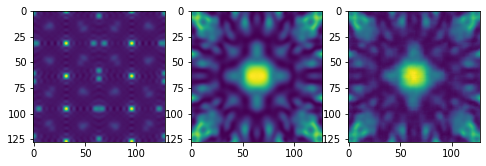

140
ZMCC loss is:  0.0032628715615162784


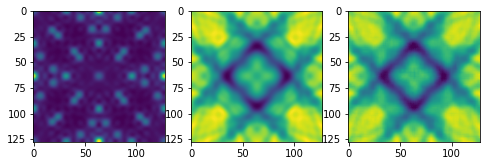

141
ZMCC loss is:  0.007102216331403177


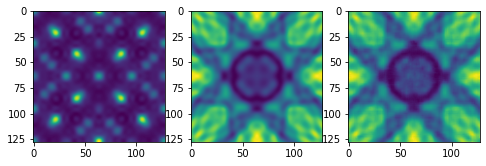

142
ZMCC loss is:  0.09924952570093815


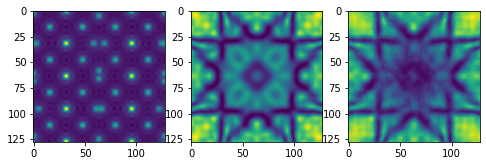

143
ZMCC loss is:  0.12290131741901755


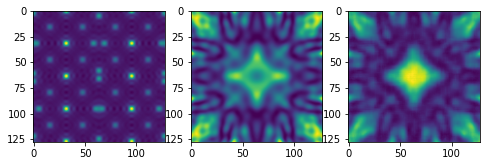

144
ZMCC loss is:  0.004537664914831763


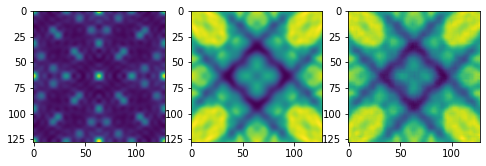

145
ZMCC loss is:  0.1556316535372091


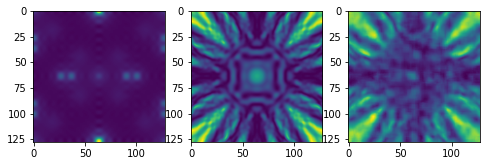

146
ZMCC loss is:  0.007202145460552978


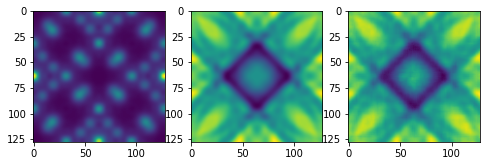

147
ZMCC loss is:  0.12446733261279319


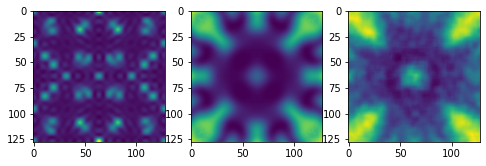

148
ZMCC loss is:  0.028808707512115728


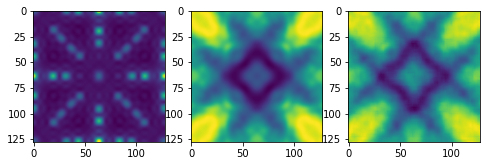

149
ZMCC loss is:  0.07427213268786592


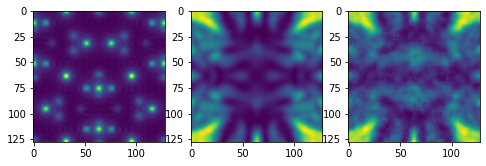

150
ZMCC loss is:  0.010100855970241573


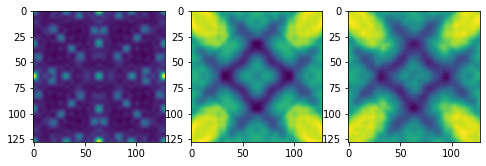

151
ZMCC loss is:  0.04782948165248835


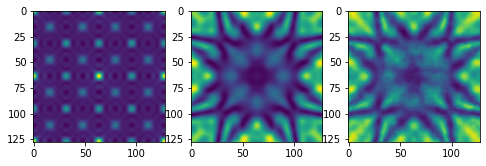

152
ZMCC loss is:  0.023110283155658884


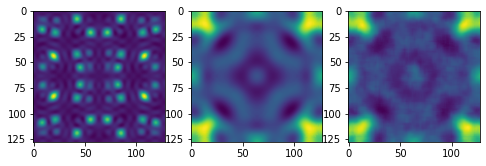

153
ZMCC loss is:  0.005451887123115062


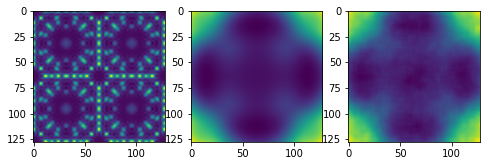

154
ZMCC loss is:  0.31943599220866226


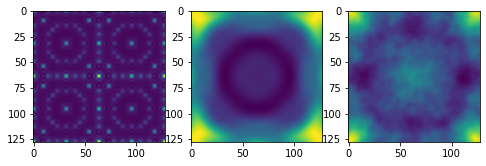

155
ZMCC loss is:  1.2944293565222278


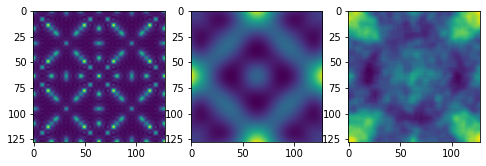

156
ZMCC loss is:  0.334434179663768


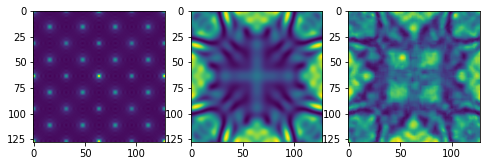

157
ZMCC loss is:  0.02657400637290308


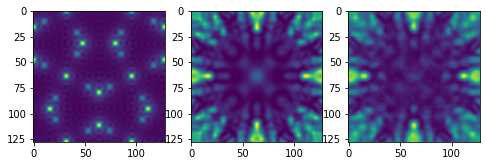

158
ZMCC loss is:  0.03775579385691297


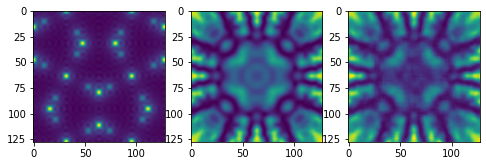

159
ZMCC loss is:  0.21201608970015862


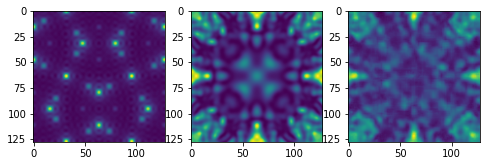

160
ZMCC loss is:  0.5303673200891743


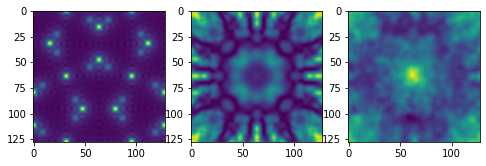

161
ZMCC loss is:  0.12139017312544231


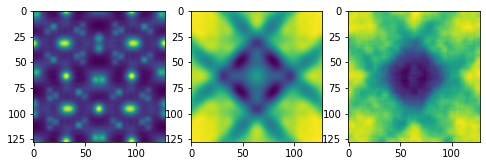

162
ZMCC loss is:  0.011846319759105217


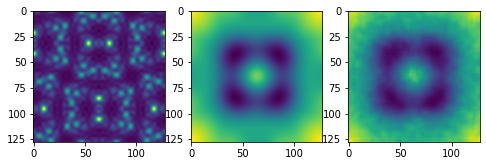

163
ZMCC loss is:  0.010670308776595694


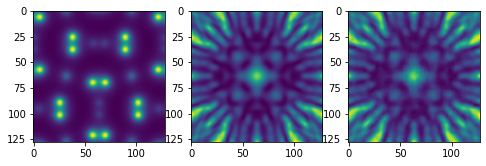

164
ZMCC loss is:  0.05512205135422976


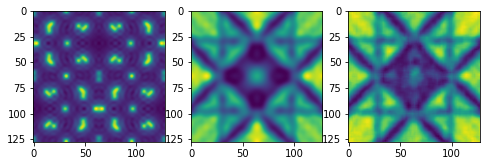

165
ZMCC loss is:  0.0054919677711811055


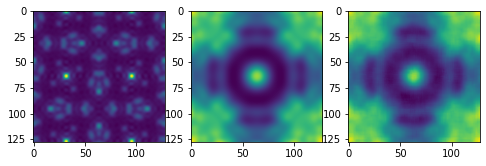

166
ZMCC loss is:  0.2055052668072822


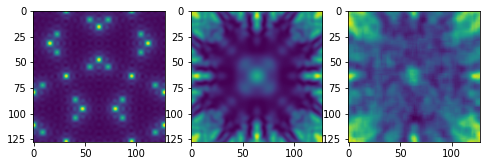

167
ZMCC loss is:  0.48565886111569956


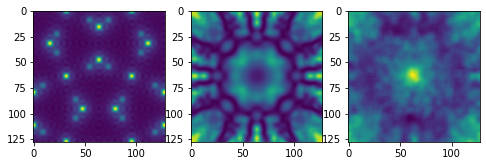

168
ZMCC loss is:  0.08197639396920153


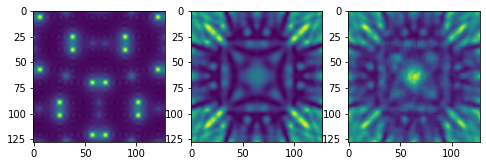

169
ZMCC loss is:  0.006918334523363101


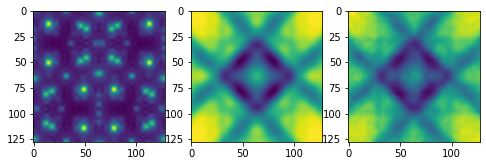

170
ZMCC loss is:  0.12457366438265982


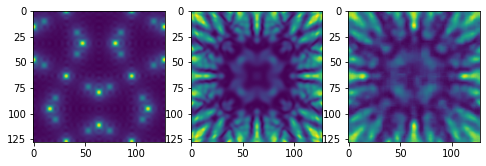

171
ZMCC loss is:  0.04345684229964397


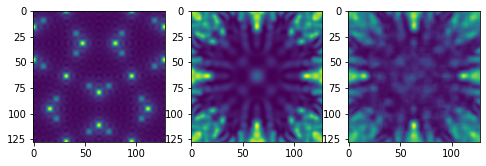

172
ZMCC loss is:  0.005374124084961407


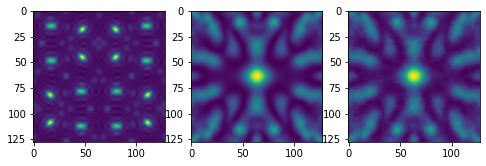

173
ZMCC loss is:  0.046753300929022634


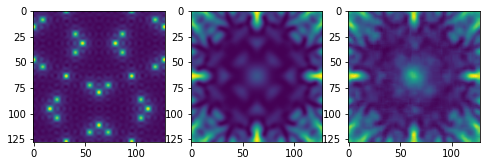

174
ZMCC loss is:  0.3583631556010598


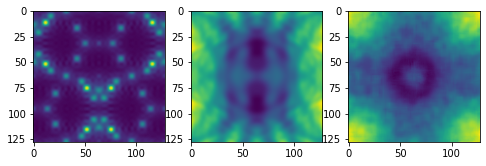

175
ZMCC loss is:  0.038845186800510634


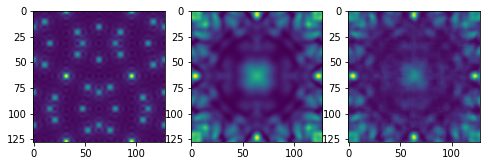

176
ZMCC loss is:  0.026716700008671546


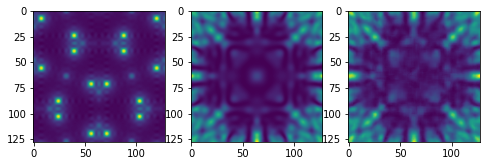

177
ZMCC loss is:  0.0034480104032080794


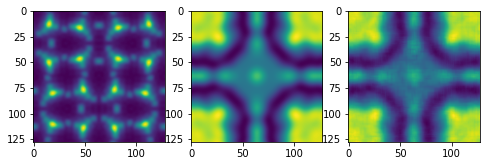

178
ZMCC loss is:  0.008909141202570137


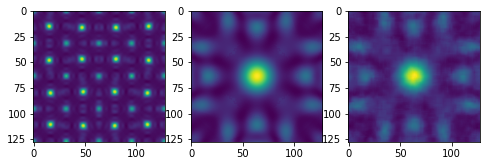

179
ZMCC loss is:  0.05129774278243182


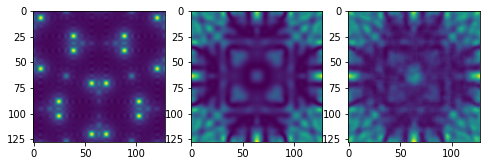

180
ZMCC loss is:  0.027083064665234025


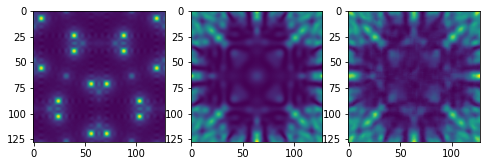

181
ZMCC loss is:  0.7377105660465595


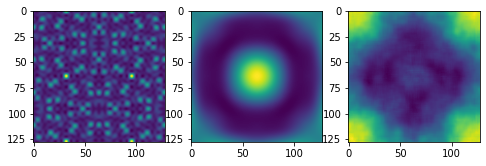

182
ZMCC loss is:  0.020627081537390235


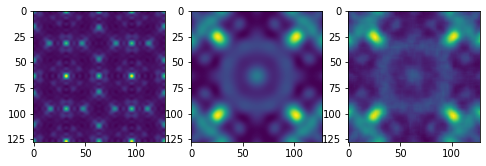

183
ZMCC loss is:  0.08425785866328217


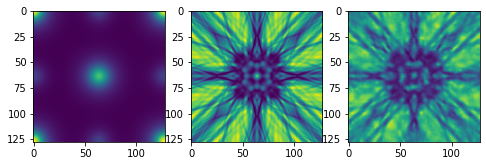

184
ZMCC loss is:  0.0018130608389760328


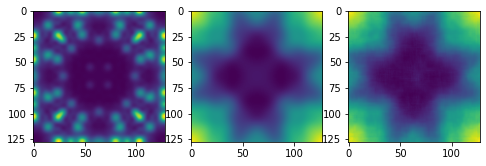

185
ZMCC loss is:  0.0028685472441566384


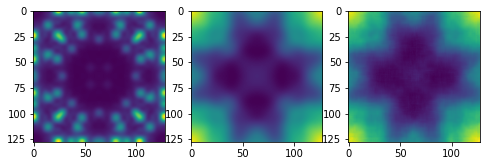

186
ZMCC loss is:  0.1976714314420953


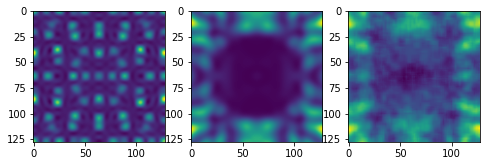

187
ZMCC loss is:  0.011253002780222676


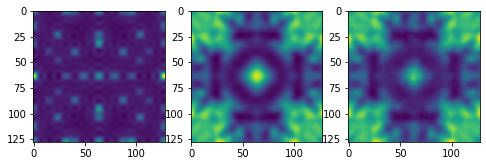

188
ZMCC loss is:  0.04341630240486949


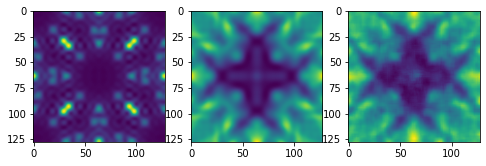

189
ZMCC loss is:  0.024215300170639886


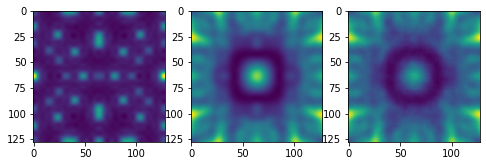

190
ZMCC loss is:  0.038809385744908775


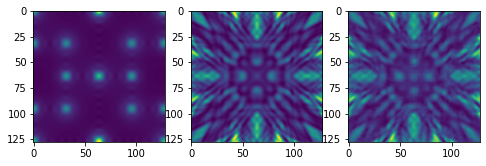

191
ZMCC loss is:  0.005327692649026883


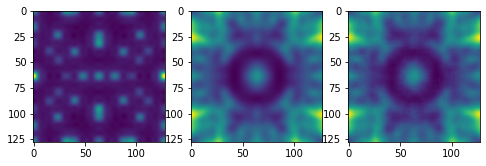

192
ZMCC loss is:  0.20924919675421783


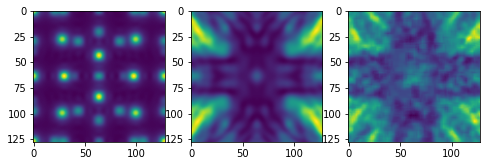

193
ZMCC loss is:  0.01822723253903269


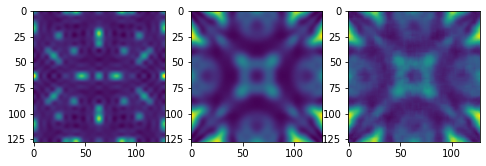

194
ZMCC loss is:  0.049999059403909585


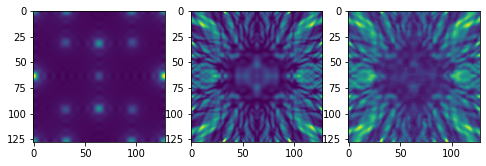

195
ZMCC loss is:  0.08469212523948444


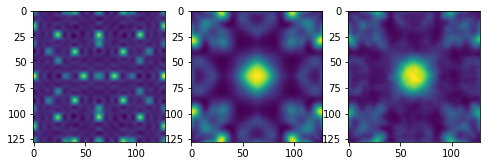

196
ZMCC loss is:  0.05086472651661922


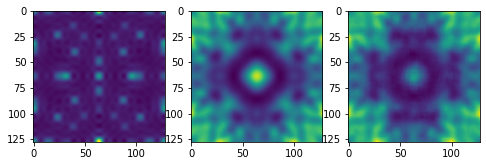

197
ZMCC loss is:  0.04432136030051359


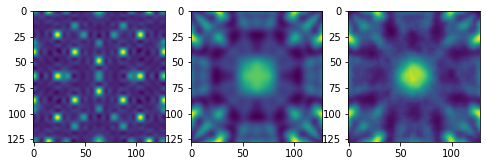

198
ZMCC loss is:  0.014217936180986324


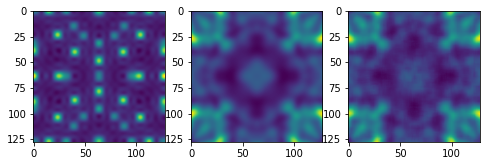

199
ZMCC loss is:  0.02833433774019556


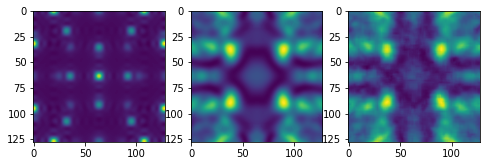

200
ZMCC loss is:  0.005251008292684323


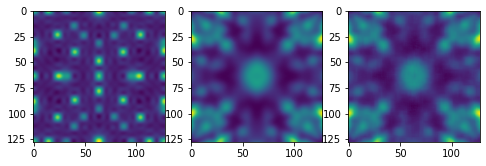

201
ZMCC loss is:  0.04016964008309043


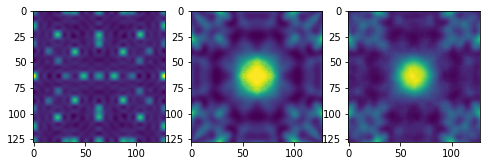

202
ZMCC loss is:  0.010450656603213426


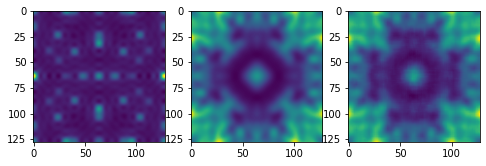

203
ZMCC loss is:  0.018574359145171693


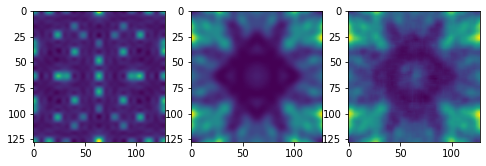

204
ZMCC loss is:  0.07002720224645909


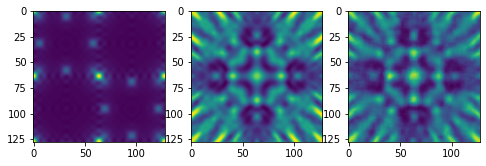

205
ZMCC loss is:  0.30786273636115236


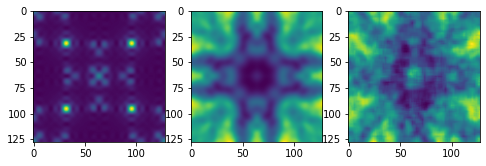

206
ZMCC loss is:  0.10649192094214155


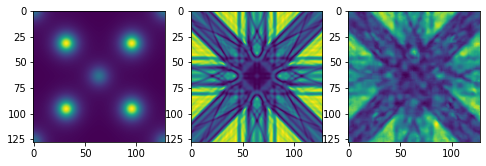

207
ZMCC loss is:  0.010102125028237596


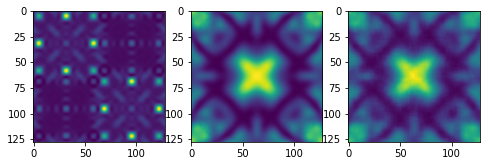

208
ZMCC loss is:  0.009206158704908263


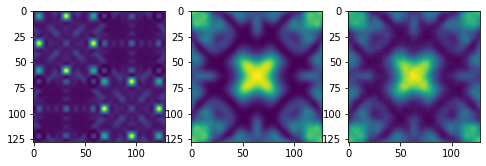

209
ZMCC loss is:  0.03665496664703283


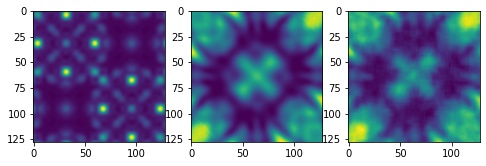

210
ZMCC loss is:  0.14436078715022072


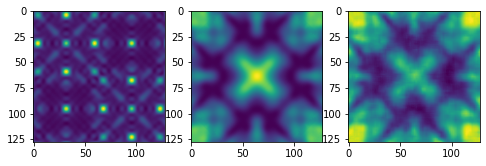

211
ZMCC loss is:  0.05488515423458995


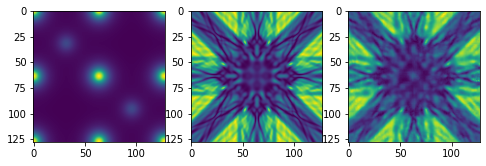

212
ZMCC loss is:  0.15483949270086694


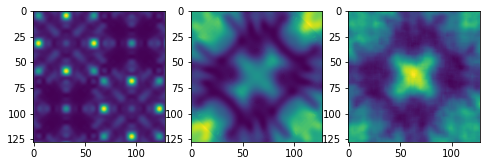

213
ZMCC loss is:  0.01833615065271621


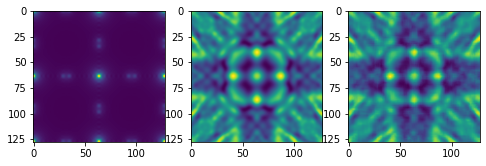

214
ZMCC loss is:  0.4283929387636609


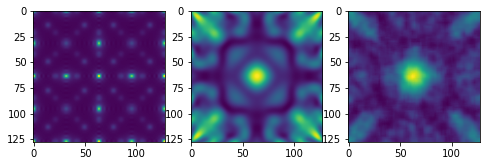

215
ZMCC loss is:  0.1152805651598684


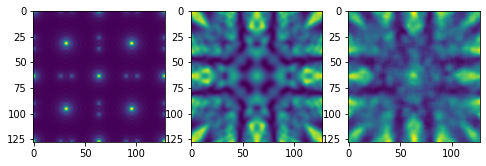

216
ZMCC loss is:  0.3120892431164819


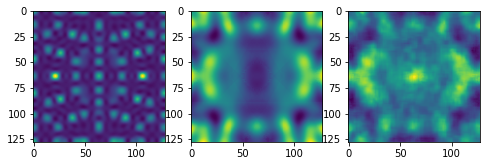

217
ZMCC loss is:  0.06616638096450911


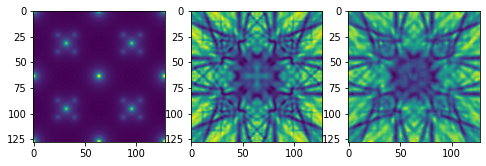

218
ZMCC loss is:  0.07320366226477004


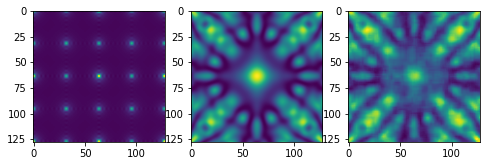

219
ZMCC loss is:  0.02434060508100855


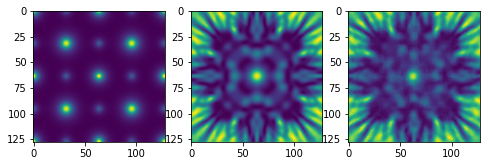

220
ZMCC loss is:  0.2502901509246396


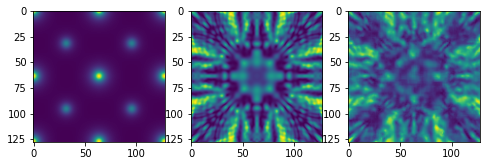

221
ZMCC loss is:  0.02973470355092922


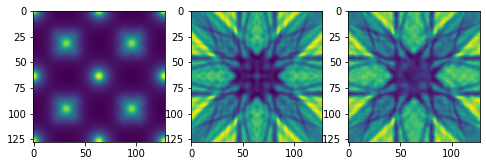

222
ZMCC loss is:  0.03380981251524373


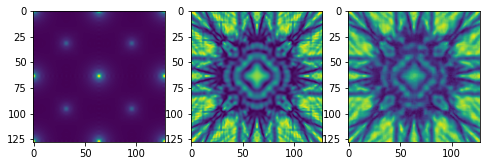

223
ZMCC loss is:  0.30223522469228925


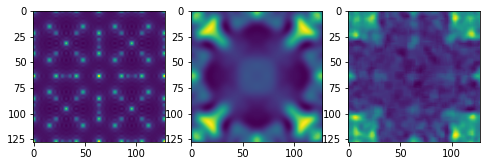

224
ZMCC loss is:  0.021100927253821067


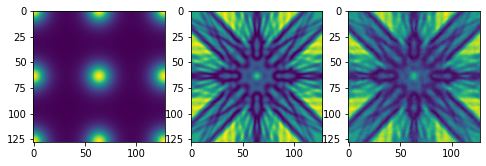

225
ZMCC loss is:  0.0977900691266812


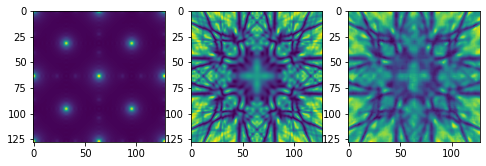

226
ZMCC loss is:  0.24400332011676018


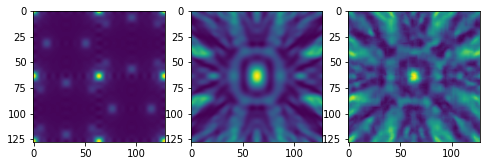

227
ZMCC loss is:  0.007776309891794564


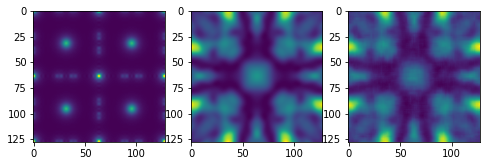

228
ZMCC loss is:  0.010027347829988043


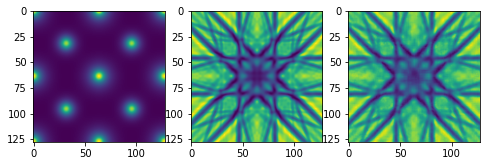

229
ZMCC loss is:  0.015223989567406115


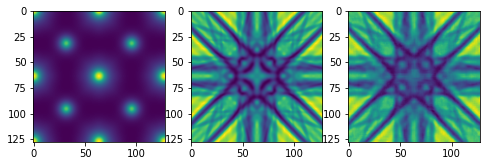

230
ZMCC loss is:  0.006832209944895307


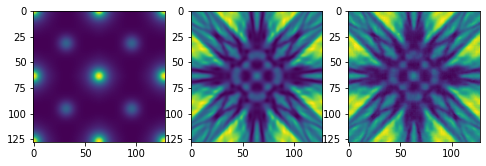

231
ZMCC loss is:  0.03191027027270832


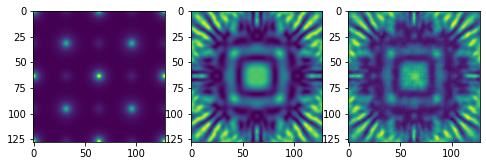

232
ZMCC loss is:  0.19382641931393585


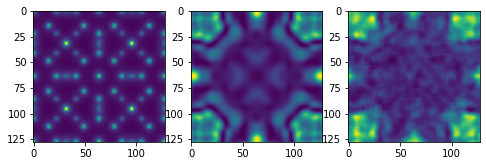

233
ZMCC loss is:  0.2503552437404202


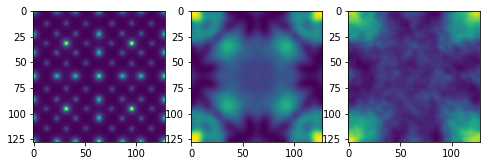

234
ZMCC loss is:  0.015600551232437865


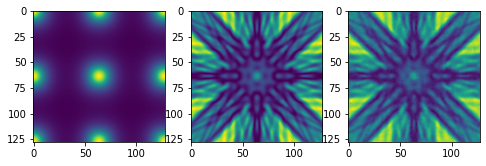

235
ZMCC loss is:  0.02685243923837266


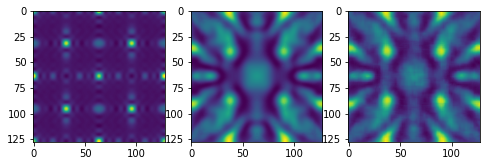

236
ZMCC loss is:  0.022766343097461617


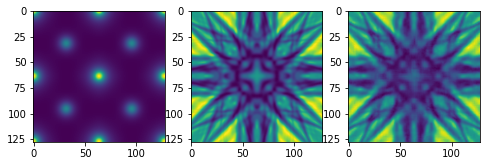

237
ZMCC loss is:  0.028788668054733235


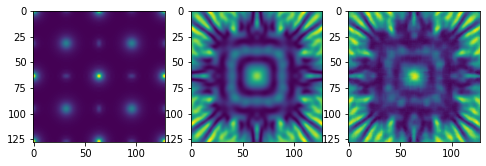

238
ZMCC loss is:  0.04698335591667269


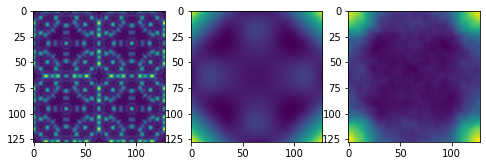

239
ZMCC loss is:  0.001451404903180853


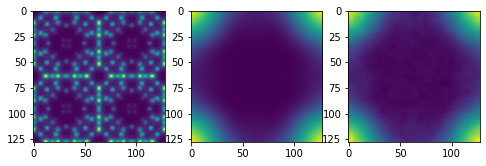

240
ZMCC loss is:  0.035500865174406315


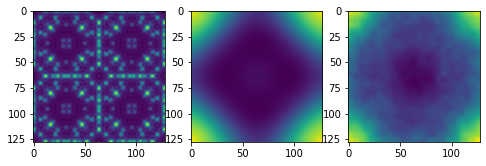

241
ZMCC loss is:  0.03017430092830642


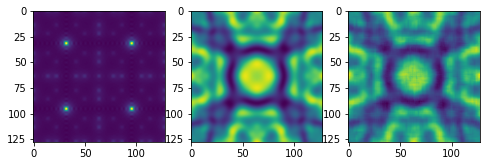

242
ZMCC loss is:  0.5329816002341368


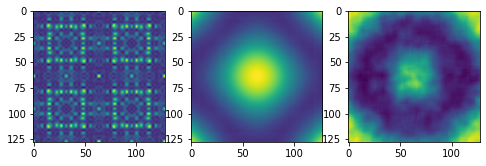

243
ZMCC loss is:  0.007217306287503611


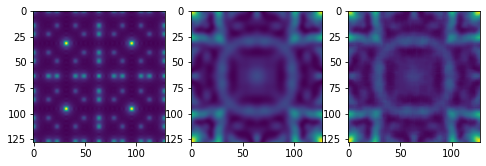

244
ZMCC loss is:  0.3959168349347397


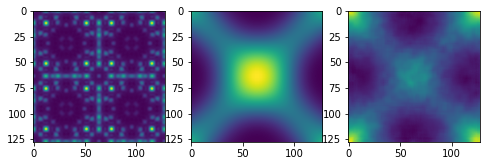

245
ZMCC loss is:  0.013619444841116657


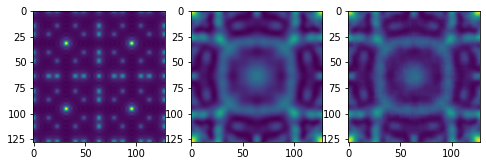

246
ZMCC loss is:  0.017129739319608817


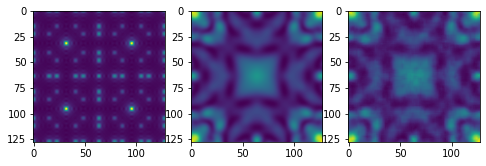

247
ZMCC loss is:  0.01506067063216121


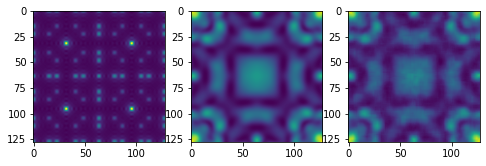

248
ZMCC loss is:  0.6192660669223522


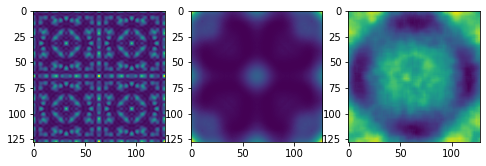

249
ZMCC loss is:  0.06471595452756684


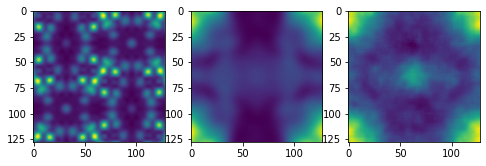

250
ZMCC loss is:  0.14100425864582145


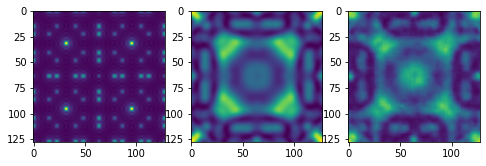

251
ZMCC loss is:  0.39173258725973414


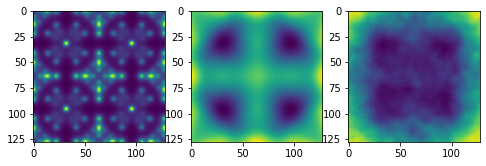

252
ZMCC loss is:  0.060753196238129914


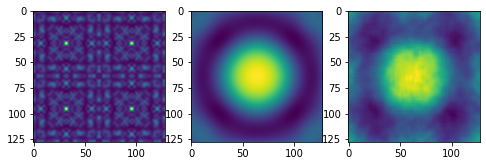

253
ZMCC loss is:  0.06676417684034375


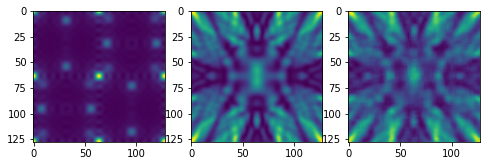

254
ZMCC loss is:  0.032531371870454406


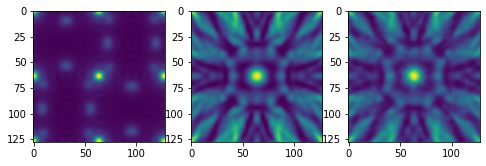

255
ZMCC loss is:  0.026942160173879515


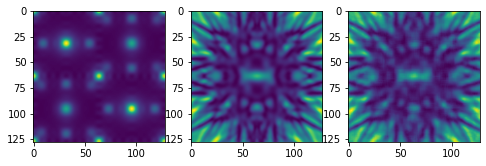

256
ZMCC loss is:  0.17821461696691698


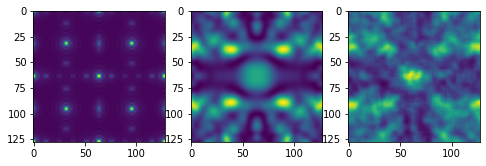

257
ZMCC loss is:  0.16117375919764354


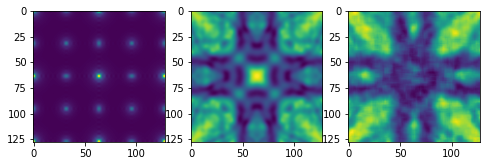

258
ZMCC loss is:  0.5073338939162844


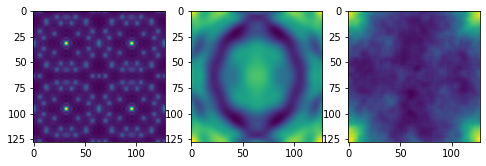

259
ZMCC loss is:  0.007752313295477431


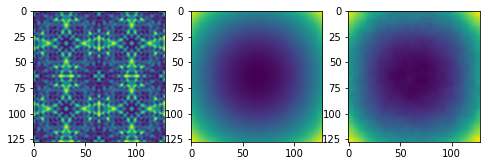

260
ZMCC loss is:  0.0508624430754947


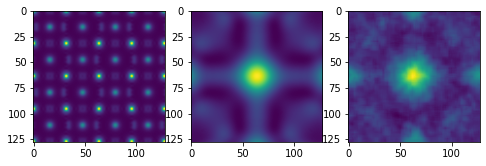

261
ZMCC loss is:  0.00678846962592039


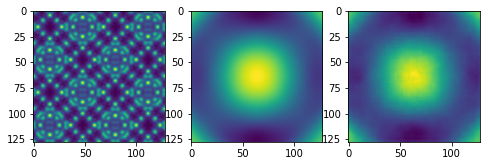

262
ZMCC loss is:  0.03465788546219217


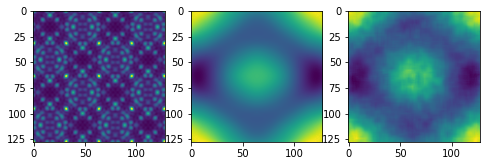

Average loss:  0.0
Average ZMCC is:  0.10706610400348238


In [11]:
average_loss = 0

#data = [i for i in gen_paths_labels(data_path)]
#data[0][0], data[0][1]
Mean_ZMCC = 0
lowest_loss = np.inf
vae.encoder.sampling.gamma=0
for i in range(0, len(TestPathsInput)):
    x = np.load(TestPathsInput[i])
    y = np.load(TestPathsOutput[i])

    a = np.reshape(vae(np.reshape(x, (1, 128, 128, 1))), (128, 128))
    zmcc = ZMCC_loss(a,y)
    
    Mean_ZMCC+=zmcc
    
    if log_loss > -2:
        print(i)
        print("ZMCC loss is: ", zmcc)
        w=10
        h=10
        fig=plt.figure(figsize=(8, 8))
        columns = 3
        rows = 1
        fig.add_subplot(rows, columns, 1)
        plt.imshow(x)
        fig.add_subplot(rows, columns, 2)
        plt.imshow(y)
        fig.add_subplot(rows, columns, 3)
        plt.imshow(a)
        plt.show()
    
    

print("Average loss: ", average_loss / len(TestPathsInput))
print("Average ZMCC is: ", Mean_ZMCC / len(TestPathsInput))

63
ZMCC loss is:  0.01958529193237879


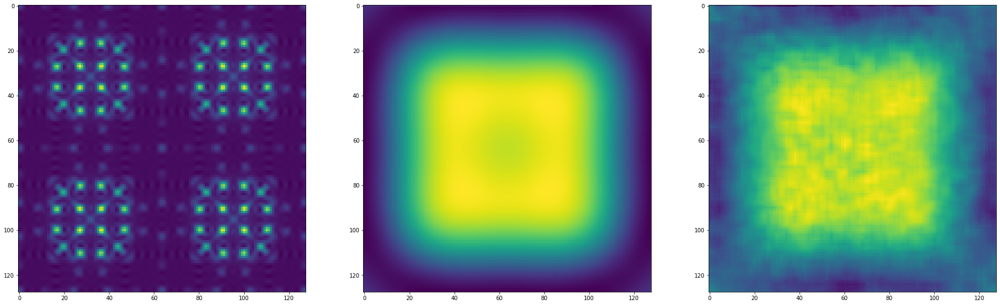

245
ZMCC loss is:  0.013619444841116657


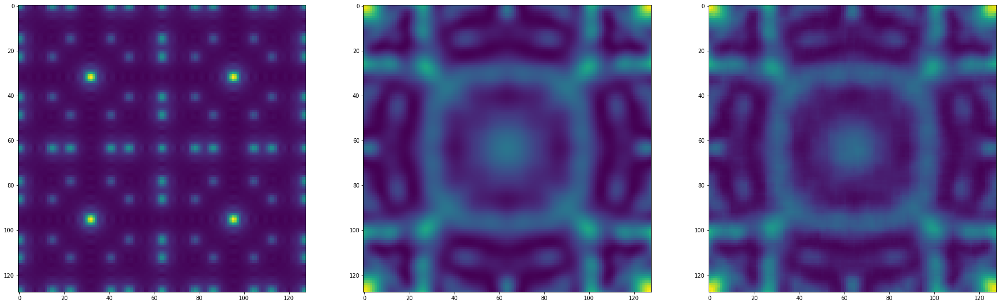

242
ZMCC loss is:  0.5329816002341368


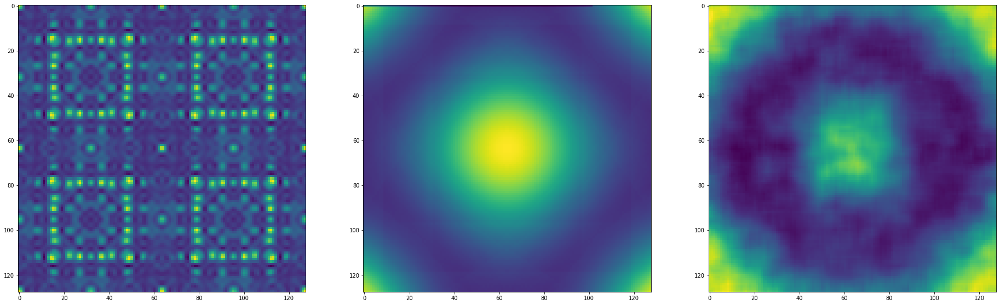

In [12]:
PlotCrystals = [63, 245, 242]

for i in PlotCrystals:
    x = np.load(TestPathsInput[i])
    y = np.load(TestPathsOutput[i])

    a = np.reshape(vae(np.reshape(x, (1, 128, 128, 1))), (128, 128))
    zmcc = ZMCC_loss(a,y)
    
    Mean_ZMCC+=zmcc
    
    if zmcc > 0:
        print(i)
        print("ZMCC loss is: ", zmcc)
        w=10
        h=10
        fig=plt.figure(figsize=(32, 32))
        columns = 3
        rows = 1
        fig.add_subplot(rows, columns, 1)
        plt.imshow(x)
        fig.add_subplot(rows, columns, 2)
        plt.imshow(y)
        fig.add_subplot(rows, columns, 3)
        plt.imshow(a)
        plt.show()

In [ ]:
for i in range(0, len(TrainingPathsInput)):
    #x = np.load(data[0][0][i])
    #y = np.load(data[0][1][i])
    x = np.load(TrainingPathsInput[i])
    y = np.load(TrainingPathsOutput[i])
    a = np.reshape(vae(np.reshape(x, (1, 128, 128, 1))), (128, 128))
    #print(TrainingPathsInput[i])

    w=10
    h=10
    fig=plt.figure(figsize=(8, 8))
    columns = 3
    rows = 1
    fig.add_subplot(rows, columns, 1)
    plt.imshow(x)
    fig.add_subplot(rows, columns, 2)
    plt.imshow(y)
    fig.add_subplot(rows, columns, 3)
    plt.imshow(a)
    plt.show()

In [ ]:
a = np.load("/home/ug-ml/felix-ML/VAE_000/DataAllInOne_Normalised/VAE_000_2/Data/AllData/79/Input.npy")
b = np.reshape(vae(np.reshape(a, (1, 128, 128, 1))), (128, 128))
w=10
h=10
fig=plt.figure(figsize=(8, 8))
columns = 2
rows = 1
fig.add_subplot(rows, columns, 1)

plt.imshow(a)
fig.add_subplot(rows, columns, 2)
plt.imshow(b)
plt.show()